In [1]:
# 구현에 사용할 패키지 임포트하기
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

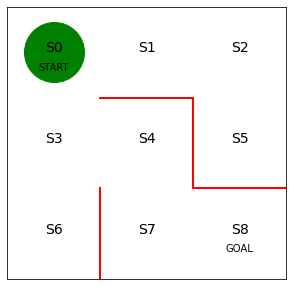

In [2]:
# 초기 상태의 미로 모습

# 전체 그림의 크기 및 그림을 나타내는 변수 선언
fig = plt.figure(figsize=(5, 5))
ax = plt.gca()

# 붉은 벽 그리기
plt.plot([1, 1], [0, 1], color='red', linewidth=2)
plt.plot([1, 2], [2, 2], color='red', linewidth=2)
plt.plot([2, 2], [2, 1], color='red', linewidth=2)
plt.plot([2, 3], [1, 1], color='red', linewidth=2)

# 상태를 의미하는 문자열(S0~S8) 표시
plt.text(0.5, 2.5, 'S0', size=14, ha='center')
plt.text(1.5, 2.5, 'S1', size=14, ha='center')
plt.text(2.5, 2.5, 'S2', size=14, ha='center')
plt.text(0.5, 1.5, 'S3', size=14, ha='center')
plt.text(1.5, 1.5, 'S4', size=14, ha='center')
plt.text(2.5, 1.5, 'S5', size=14, ha='center')
plt.text(0.5, 0.5, 'S6', size=14, ha='center')
plt.text(1.5, 0.5, 'S7', size=14, ha='center')
plt.text(2.5, 0.5, 'S8', size=14, ha='center')
plt.text(0.5, 2.3, 'START', ha='center')
plt.text(2.5, 0.3, 'GOAL', ha='center')

# 그림을 그릴 범위 및 눈금 제거 설정
ax.set_xlim(0, 3)
ax.set_ylim(0, 3)
plt.tick_params(axis='both', which='both', bottom=False, top=False,
                labelbottom=False, right=False, left=False, labelleft=False)

# S0에 녹색 원으로 현재 위치를 표시
line, = ax.plot([0.5], [2.5], marker="o", color='g', markersize=60)

In [3]:
# 정책을 결정하는 파라미터의 초깃값 theta_0를 설정

# 줄은 상태 0~7, 열은 행동방향(상,우,하,좌 순)를 나타낸다.
theta_0 = np.array([[np.nan, 1, 1, np.nan],     # s0
                    [np.nan, 1, np.nan, 1],     # s1
                    [np.nan, np.nan, 1, 1],     # s2
                    [1, 1, 1, np.nan],          # s3
                    [np.nan, np.nan, 1, 1],     # s4
                    [1, np.nan, np.nan, np.nan],# s5
                    [1, np.nan, np.nan, np.nan],# s6
                    [1, 1, np.nan, np.nan],     # s7
                    ])                          # s8은 목표지점이므로 정책이 없다 

In [4]:
# 정책 파라미터 theta를 행동정책 pi로 변환(softmax 함수를 사용함)하는 함수

def softmax_convert_into_pi_from_theta(theta):
    '''비율 계산에 소프트맥스 함수 사용'''
    
    beta = 1.0
    [m,n] = theta.shape  # theta 행렬의 크기를 구함
    pi = np.zeros((m,n))
    
    exp_theta = np.exp(beta * theta)  # theta를 exp(theta)로 변환함
    
    for i in range(0, m):
        # 단순 비율을 계산하는 코드
        # pi[i,:] =theta[i,:]/np.nansum(theta[i,:])
        
        # 소프트맥스로 계산하는 코드
        pi[i,:] = exp_theta[i,:] / np.nansum(exp_theta[i,:])
        
    pi = np.nan_to_num(pi)  # nan을 0으로 변환함
    
    return pi


In [5]:
# 초기 정책 pi_0을 계산함
pi_0 = softmax_convert_into_pi_from_theta(theta_0)
print(pi_0)

[[0.         0.5        0.5        0.        ]
 [0.         0.5        0.         0.5       ]
 [0.         0.         0.5        0.5       ]
 [0.33333333 0.33333333 0.33333333 0.        ]
 [0.         0.         0.5        0.5       ]
 [1.         0.         0.         0.        ]
 [1.         0.         0.         0.        ]
 [0.5        0.5        0.         0.        ]]


In [6]:
# 소프트맥스 함수로 계산한 정책을 이용해 에이전트를 움직이는 함수를 구현함
# 행동 a와 1단계 후의 상태 s를 구하는 함수

def get_action_and_next_s(pi,s):
    direction = ["up", "right", "down", "left"]
    # pi[s,:]의 확률에 따라 direction 값이 선택됨
    
    next_direction = np.random.choice(direction, p = pi[s,:])
    
    if next_direction == "up":
        action = 0
        s_next = s - 3  # 위로 이동하면 상태값이 3만큼 줄어든다
        
    elif next_direction == "right":
        action = 0
        s_next = s + 1  # 오른쪽로 이동하면 상태값이 1만큼 늘어난다
        
    elif next_direction == "down":
        action = 0
        s_next = s + 3  # 아래로 이동하면 상태값이 3만큼 늘어난다
        
    elif next_direction == "left":
        action = 0
        s_next = s - 1  # 왼쪽으로 이동하면 상태값이 1만큼 줄어든다
        
    return [action, s_next]

In [7]:
# 목표 지점에 다다를 때까지 에이전트를 움직이는 함수 -> goal_maze
# 상태 외에도 해당 상태에서 취했던 "행동"에 대한 정보도 모아두도록 함 -> goal_maze_ret_s_a
# goal_maze_ret_s_a() : goal_maze() 함수의 상태(state), 행동(action)을 함께 반환하는 버전
# 미로를 빠져 나오는 함수, 상태와 행동의 히스토리를 출력함

def goal_maze_ret_s_a(pi):
    s = 0  # 시작 시점
    s_a_history = [[0, np.nan]]  # 에이전트의 행동 및 상태의 히스토리를 기록하는 리스트
    
    while (1):  # 목표 지점에 이를 때까지 반복함
        [action, next_s] = get_action_and_next_s(pi,s)
        s_a_history[-1][1] = action
        # 현재 상태(마지막이므로 인덱스가 -1임)를 히스토리에 추가함
    
        s_a_history.append([next_s, np.nan])
        # 다음 상태를 히스토리에 추가함
        # 행동은 아직 알 수 없으므로 nan으로 둠
    
        if next_s == 8:  # 목표 지점에 이르면 종료함
            break
        else:
            s = next_s
    
    return s_a_history

In [8]:
# 초기 정책으로 미로를 빠져나옴
# 상태와 행동의 짝으로 출력됨
# 모교에 이르기까지 걸린 전체 단계 수가 출력됨
s_a_history = goal_maze_ret_s_a(pi_0)
print(s_a_history)
print("목표 지점에 이르기까지 걸린 단계 수는 " + str(len(s_a_history)-1) + "단계 입니다!")

[[0, 0], [1, 0], [2, 0], [5, 0], [2, 0], [1, 0], [0, 0], [1, 0], [2, 0], [5, 0], [2, 0], [5, 0], [2, 0], [5, 0], [2, 0], [1, 0], [2, 0], [5, 0], [2, 0], [5, 0], [2, 0], [1, 0], [2, 0], [5, 0], [2, 0], [1, 0], [0, 0], [3, 0], [0, 0], [1, 0], [2, 0], [1, 0], [2, 0], [1, 0], [0, 0], [1, 0], [2, 0], [1, 0], [2, 0], [5, 0], [2, 0], [5, 0], [2, 0], [5, 0], [2, 0], [1, 0], [2, 0], [1, 0], [0, 0], [3, 0], [6, 0], [3, 0], [6, 0], [3, 0], [4, 0], [3, 0], [4, 0], [3, 0], [4, 0], [7, 0], [4, 0], [3, 0], [6, 0], [3, 0], [4, 0], [7, 0], [4, 0], [3, 0], [0, 0], [3, 0], [6, 0], [3, 0], [4, 0], [3, 0], [4, 0], [7, 0], [8, nan]]
목표 지점에 이르기까지 걸린 단계 수는 76단계 입니다!


In [9]:
# 정책경사 알고리즘으로 정책을 수정함
# 이 수정식 : update_theta
# 입력 : 현재의 theta, 정책 pi, 현재 정책을 적용한 실행 결과 s_a_history
# theta를 수정하는 함수
def update_theta(theta, pi, s_a_history):
    eta = 0.1  # 학습률
    T = len(s_a_history)  # 목표 지점에 이르기까지 걸린 단계의 수
    
    [m, n] = theta.shape  # theta의 행렬 크기를 구함
    delta_theta = theta.copy()  # delta theta를 구할 준비를 함
    '''
    포인터 참조이므로 delta_theta = theta 로 구현하면, 한쪽을 수정하려고 하면 다른 한쪽도 수정되는 현상이 발생함\
    이 현상을 방지하기 위해서 서로 다른 변수로 구현하려면, 변수명.copy() 를 사용해 내용을 복제해야 함
    ''' 
    
    # delta_theta를 요소 단위로 계산함
    for i in range(0,m):
        for j in range(0,n):
            if not(np.isnan(theta[i,j])):  # theta가 nan이 아닌 경우
                SA_i = [SA for SA in s_a_history if SA[0] == i]  # 히스토리에서 상태 i(s_i)인 것만 모아오는 리스트 컴프리헨션
                
                SA_ij = [SA for SA in s_a_history if SA == [i,j]]  # 상태 i에서 행동 j를 취한 경우만 모아옴
                
                N_i = len(SA_i)    # 상태 i에서 모든 행동을 취한 횟수
                N_ij = len(SA_ij)  # 상태 i에서 행동 j를 취한 횟수
                
                delta_theta[i,j] = (N_ij - pi[i,j]*N_i)/T
    
    new_theta = theta + eta*delta_theta
    
    return new_theta            

In [10]:
# 정책을 수정함
new_theta = update_theta(theta_0, pi_0, s_a_history)
pi = softmax_convert_into_pi_from_theta(new_theta)
print(pi)

[[0.         0.5        0.5        0.        ]
 [0.         0.5        0.         0.5       ]
 [0.         0.         0.5        0.5       ]
 [0.33680549 0.33159726 0.33159726 0.        ]
 [0.         0.         0.5        0.5       ]
 [1.         0.         0.         0.        ]
 [1.         0.         0.         0.        ]
 [0.50097402 0.49902598 0.         0.        ]]


In [11]:
# 미로에서 목표 지점으로 바로 갈 수 있을 만큼 파라미터 theta를 반복해서 수정하도록 하는 가장 바깥쪽 반복문
stop_epsilon = 10**-4  # 정책의 변화가 10^-4 보다 작아지면 학습을 종료함

theta = theta_0
pi = pi_0

is_continue = True
count = 1

while is_continue:  # is_continue 가 False가 될 때까지 반복함
    s_a_history = goal_maze_ret_s_a(pi)  # 정책 pi를 따라 미로를 탐색한 히스토리를 구함
    new_theta = update_theta(theta, pi, s_a_history)  # 파라미터 theta를 수정함
    new_pi = softmax_convert_into_pi_from_theta(new_theta)  # 정책 pi를 수정함
    
    print(np.sum(np.abs(new_pi-pi)))  # 정책의 변화를 출력함
    print("목표 지점에 이르기까지 걸린 단계 수는 " + str(len(s_a_history)-1) + "단계입니다")
    
    if np.sum(np.abs(new_pi-pi)) < stop_epsilon:
        is_continue = False
    else:
        theta = new_theta
        pi = new_pi    

0.007295921009299544
목표 지점에 이르기까지 걸린 단계 수는 128단계입니다
0.013436322033963832
목표 지점에 이르기까지 걸린 단계 수는 16단계입니다
0.014746540004933695
목표 지점에 이르기까지 걸린 단계 수는 72단계입니다
0.0060448189012135
목표 지점에 이르기까지 걸린 단계 수는 44단계입니다
0.021659836544218547
목표 지점에 이르기까지 걸린 단계 수는 18단계입니다
0.012102285223602016
목표 지점에 이르기까지 걸린 단계 수는 52단계입니다
0.009582635170326481
목표 지점에 이르기까지 걸린 단계 수는 18단계입니다
0.020224024983039768
목표 지점에 이르기까지 걸린 단계 수는 8단계입니다
0.008148969416026164
목표 지점에 이르기까지 걸린 단계 수는 38단계입니다
0.012533925770905174
목표 지점에 이르기까지 걸린 단계 수는 38단계입니다
0.013178937283725378
목표 지점에 이르기까지 걸린 단계 수는 16단계입니다
0.005268272428495813
목표 지점에 이르기까지 걸린 단계 수는 126단계입니다
0.012364443601889208
목표 지점에 이르기까지 걸린 단계 수는 28단계입니다
0.01834452805317527
목표 지점에 이르기까지 걸린 단계 수는 4단계입니다
0.010772946583447573
목표 지점에 이르기까지 걸린 단계 수는 36단계입니다
0.02046184328831091
목표 지점에 이르기까지 걸린 단계 수는 14단계입니다
0.014580962534160025
목표 지점에 이르기까지 걸린 단계 수는 14단계입니다
0.00833119639356572
목표 지점에 이르기까지 걸린 단계 수는 138단계입니다
0.02043866842224379
목표 지점에 이르기까지 걸린 단계 수는 8단계입니다
0.006667426927779052
목표 지점에 이르기까지 걸린 

0.002157087158823817
목표 지점에 이르기까지 걸린 단계 수는 152단계입니다
0.0018891998987141112
목표 지점에 이르기까지 걸린 단계 수는 382단계입니다
0.002931046411088545
목표 지점에 이르기까지 걸린 단계 수는 60단계입니다
0.002731496083483498
목표 지점에 이르기까지 걸린 단계 수는 64단계입니다
0.002086761178395735
목표 지점에 이르기까지 걸린 단계 수는 308단계입니다
0.004302379162581443
목표 지점에 이르기까지 걸린 단계 수는 64단계입니다
0.004251575204851699
목표 지점에 이르기까지 걸린 단계 수는 138단계입니다
0.0017603084565747107
목표 지점에 이르기까지 걸린 단계 수는 46단계입니다
0.0021181826953139415
목표 지점에 이르기까지 걸린 단계 수는 258단계입니다
0.0018517680924467483
목표 지점에 이르기까지 걸린 단계 수는 652단계입니다
0.0021065455497595587
목표 지점에 이르기까지 걸린 단계 수는 62단계입니다
0.0015364677228001666
목표 지점에 이르기까지 걸린 단계 수는 192단계입니다
0.0019339667531073634
목표 지점에 이르기까지 걸린 단계 수는 28단계입니다
0.004138860854871224
목표 지점에 이르기까지 걸린 단계 수는 118단계입니다
0.0029212962656459396
목표 지점에 이르기까지 걸린 단계 수는 52단계입니다
0.0036252013295549335
목표 지점에 이르기까지 걸린 단계 수는 38단계입니다
0.008554610368812887
목표 지점에 이르기까지 걸린 단계 수는 4단계입니다
0.0019235561980576465
목표 지점에 이르기까지 걸린 단계 수는 222단계입니다
0.0013811538286546965
목표 지점에 이르기까지 걸린 단계 수는 752단계입니다
0.001292803

0.0006009207719481768
목표 지점에 이르기까지 걸린 단계 수는 484단계입니다
0.0008775060774329768
목표 지점에 이르기까지 걸린 단계 수는 592단계입니다
0.0017491352502516933
목표 지점에 이르기까지 걸린 단계 수는 34단계입니다
0.0005243659639556086
목표 지점에 이르기까지 걸린 단계 수는 782단계입니다
0.0009870348985705768
목표 지점에 이르기까지 걸린 단계 수는 158단계입니다
0.0010561334945272116
목표 지점에 이르기까지 걸린 단계 수는 424단계입니다
0.0007633160906879433
목표 지점에 이르기까지 걸린 단계 수는 236단계입니다
0.0014420291762801685
목표 지점에 이르기까지 걸린 단계 수는 180단계입니다
0.0007711998891716809
목표 지점에 이르기까지 걸린 단계 수는 366단계입니다
0.0012941051282148452
목표 지점에 이르기까지 걸린 단계 수는 122단계입니다
0.002204350008803535
목표 지점에 이르기까지 걸린 단계 수는 66단계입니다
0.0012893678721504487
목표 지점에 이르기까지 걸린 단계 수는 148단계입니다
0.0014791967389816973
목표 지점에 이르기까지 걸린 단계 수는 82단계입니다
0.0011627444744551907
목표 지점에 이르기까지 걸린 단계 수는 66단계입니다
0.0014625238473659485
목표 지점에 이르기까지 걸린 단계 수는 26단계입니다
0.0008880615596174868
목표 지점에 이르기까지 걸린 단계 수는 38단계입니다
0.0007545633091116666
목표 지점에 이르기까지 걸린 단계 수는 796단계입니다
0.0007949850174461537
목표 지점에 이르기까지 걸린 단계 수는 432단계입니다
0.001005246295501555
목표 지점에 이르기까지 걸린 단계 수는 292단계입니다
0

0.00046704952123208243
목표 지점에 이르기까지 걸린 단계 수는 518단계입니다
0.0005469871778072677
목표 지점에 이르기까지 걸린 단계 수는 874단계입니다
0.000605765793819435
목표 지점에 이르기까지 걸린 단계 수는 260단계입니다
0.00034089949342941406
목표 지점에 이르기까지 걸린 단계 수는 386단계입니다
0.001035703112145167
목표 지점에 이르기까지 걸린 단계 수는 84단계입니다
0.001495868369443043
목표 지점에 이르기까지 걸린 단계 수는 44단계입니다
0.0004793417808705014
목표 지점에 이르기까지 걸린 단계 수는 666단계입니다
0.0005209721880076595
목표 지점에 이르기까지 걸린 단계 수는 452단계입니다
0.0002889027489329371
목표 지점에 이르기까지 걸린 단계 수는 556단계입니다
0.00032905715055431273
목표 지점에 이르기까지 걸린 단계 수는 1230단계입니다
0.00029410486104576583
목표 지점에 이르기까지 걸린 단계 수는 894단계입니다
0.0004144972009429565
목표 지점에 이르기까지 걸린 단계 수는 1034단계입니다
0.0002614258376212736
목표 지점에 이르기까지 걸린 단계 수는 542단계입니다
0.0005597561626463493
목표 지점에 이르기까지 걸린 단계 수는 376단계입니다
0.00033375790277966055
목표 지점에 이르기까지 걸린 단계 수는 682단계입니다
0.00048293690317431637
목표 지점에 이르기까지 걸린 단계 수는 116단계입니다
0.00045002418759534923
목표 지점에 이르기까지 걸린 단계 수는 344단계입니다
0.00036197463813888997
목표 지점에 이르기까지 걸린 단계 수는 1400단계입니다
0.00039216781344734997
목표 지점에 이르기까지 걸린 단

0.0004652439226277283
목표 지점에 이르기까지 걸린 단계 수는 722단계입니다
0.0003215352701533003
목표 지점에 이르기까지 걸린 단계 수는 1192단계입니다
0.0002621421284135922
목표 지점에 이르기까지 걸린 단계 수는 830단계입니다
0.0005268997428795746
목표 지점에 이르기까지 걸린 단계 수는 282단계입니다
0.00020493013730235599
목표 지점에 이르기까지 걸린 단계 수는 690단계입니다
0.0004837673864728498
목표 지점에 이르기까지 걸린 단계 수는 182단계입니다
0.0002406355024857365
목표 지점에 이르기까지 걸린 단계 수는 676단계입니다
0.000969426839222548
목표 지점에 이르기까지 걸린 단계 수는 56단계입니다
0.0004346183274595711
목표 지점에 이르기까지 걸린 단계 수는 84단계입니다
0.00020813575514856686
목표 지점에 이르기까지 걸린 단계 수는 1854단계입니다
0.00041166874228738826
목표 지점에 이르기까지 걸린 단계 수는 508단계입니다
0.0002662871133835426
목표 지점에 이르기까지 걸린 단계 수는 380단계입니다
0.0002430620669783834
목표 지점에 이르기까지 걸린 단계 수는 1698단계입니다
0.00033715676262330296
목표 지점에 이르기까지 걸린 단계 수는 930단계입니다
0.0003397264929405758
목표 지점에 이르기까지 걸린 단계 수는 1418단계입니다
0.0005639374725879415
목표 지점에 이르기까지 걸린 단계 수는 258단계입니다
0.0002292169962650331
목표 지점에 이르기까지 걸린 단계 수는 1894단계입니다
0.00034288455628242454
목표 지점에 이르기까지 걸린 단계 수는 656단계입니다
0.0004573976809405522
목표 지점에 이르기까지 걸린 단

0.00015450000777317285
목표 지점에 이르기까지 걸린 단계 수는 1846단계입니다
0.00017835941333445293
목표 지점에 이르기까지 걸린 단계 수는 826단계입니다
0.0003417768500380697
목표 지점에 이르기까지 걸린 단계 수는 106단계입니다
0.0004108671806919151
목표 지점에 이르기까지 걸린 단계 수는 336단계입니다
0.000141869769487539
목표 지점에 이르기까지 걸린 단계 수는 864단계입니다
0.0005728911576545759
목표 지점에 이르기까지 걸린 단계 수는 40단계입니다
0.0002640737728551931
목표 지점에 이르기까지 걸린 단계 수는 1100단계입니다
0.00018876245135508035
목표 지점에 이르기까지 걸린 단계 수는 2458단계입니다
0.00015557008576103093
목표 지점에 이르기까지 걸린 단계 수는 1572단계입니다
0.00041131476658406996
목표 지점에 이르기까지 걸린 단계 수는 118단계입니다
0.0002545291959902968
목표 지점에 이르기까지 걸린 단계 수는 672단계입니다
0.00018321783563819694
목표 지점에 이르기까지 걸린 단계 수는 376단계입니다
0.00017543241642999086
목표 지점에 이르기까지 걸린 단계 수는 628단계입니다
0.0003254038532516587
목표 지점에 이르기까지 걸린 단계 수는 354단계입니다
0.0002063093964690399
목표 지점에 이르기까지 걸린 단계 수는 1260단계입니다
0.0009723911161548526
목표 지점에 이르기까지 걸린 단계 수는 60단계입니다
0.000127042168565919
목표 지점에 이르기까지 걸린 단계 수는 828단계입니다
0.00015585363263168062
목표 지점에 이르기까지 걸린 단계 수는 2346단계입니다
0.00020731987992755885
목표 지점에 이르기까지 

9.666838352145879e-05
목표 지점에 이르기까지 걸린 단계 수는 2006단계입니다


In [12]:
# 학습이 끝난 정책을 확인함
np.set_printoptions(precision=3, suppress=True)  # 유효 자릿수 3, 지수는 표시하지 않도록 설정함
print(pi)

[[0.    0.5   0.5   0.   ]
 [0.    0.5   0.    0.5  ]
 [0.    0.    0.5   0.5  ]
 [0.947 0.026 0.026 0.   ]
 [0.    0.    0.5   0.5  ]
 [1.    0.    0.    0.   ]
 [1.    0.    0.    0.   ]
 [0.764 0.236 0.    0.   ]]


In [13]:
# 에이전트의 이동을 애니메이션으로 시각화함
from matplotlib import animation
from IPython.display import HTML

def init():
    # 배경 이미지를 초기화함
    line.set_data([],[])
    return (line,)

def animate(i):
    # 프레임 단위로 이미지를 생성함
    state = s_a_history[i][0]  # 현재 위치
    x = (state%3) + 0.5        # 상태의 x좌표 : 3으로 나눈 나머지 + 0.5
    y = 2.5 - int(state/3)     # y좌표 : 2.5에서 3으로 나눈 몫을 뺌
    line.set_data(x,y)
    return (line,)

# 초기화 함수와 프레임 단위 이미지 생성 함수를 사용해 애니메이션을 생성함
anim = animation.FuncAnimation(fig, animate, init_func=init, frames=len(s_a_history), interval=200, repeat=False)

HTML(anim.to_jshtml())

In [ ]:
'''
정책경사 알고리즘에 대한 이론
? 왜 정책을 계산할 때 소프트맥스를 사용했는가?
! 소프트맥스를 사용하는 이유
  파라미터 theta가 음수가 돼도 정책을 계산할 수 있기 때문임
  theta를 정책 pi로 변환하는 데 소프트맥스 함수를 사용하면 파라미터 theta가 음수여도 확률을 계산할 수 있다는 이점이 있음
  왜냐하면, exp(지수함수)의 함수값은 항상 양수이기 때문임
? theta를 수정하는 식은 왜 그런 형태여야 하는가?
! 파라미터 theta를 수정하는 방법 : 정책경사 정리(policy gradient theorem - 정책경사 알고리즘으로 품),
                                   REINFORCE(정책경사 정리를 근사적으로 구현함)
  소프트맥스 함수로 확률을 변환하고, REINFORCE 알고리즘을 사용하면,
  우리가 사용했던 theta를 수정하는 식이 유도됨
'''